In [5]:
import sys
sys.path.insert(0, "/home/pwahle/proliferating_RGC/")

import yaml
import importlib
import modules
importlib.reload(modules)
import os
from pathlib import Path
import subprocess

# load global variables and parameters
with open("../params.yml", 'r') as ymlfile:
    cfg = yaml.load(ymlfile, Loader=yaml.FullLoader)

globals().update(cfg)

from scipy import ndimage
import re
import cv2
from scipy import ndimage as ndi
import copy
import numpy as np
import matplotlib as mpl
import os
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
from skimage import io
from matplotlib_scalebar.scalebar import ScaleBar

In [20]:
rawpath = data_path + 'exp5/cycle2/MIPs/'
metadf = modules.get_metadata(rawpath)

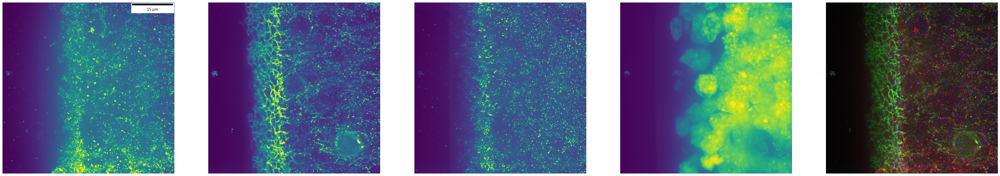

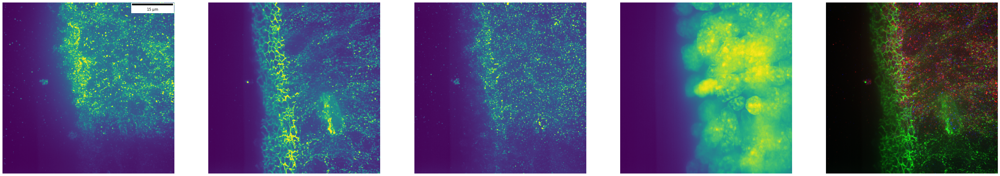

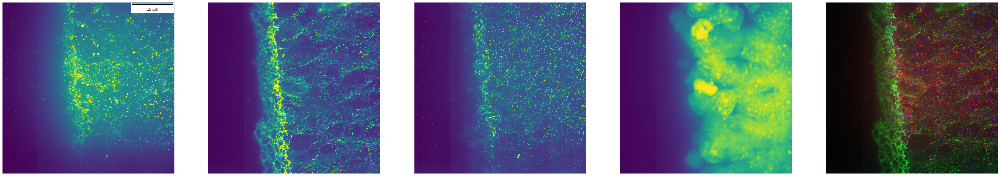

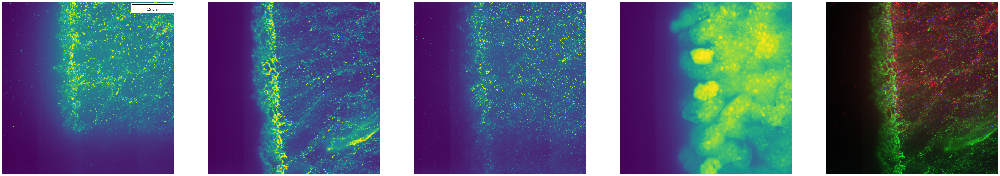

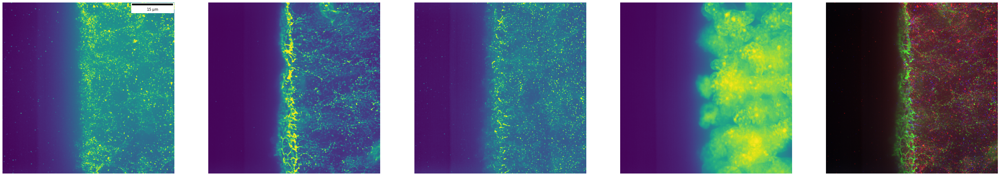

In [21]:
wells = np.unique(metadf['well_id'])

for well in wells:
    filename1 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 1)]['file'].values[0]
    filename2 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 2)]['file'].values[0]
    filename3 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 3)]['file'].values[0]
    filename4 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 4)]['file'].values[0]
    
    img1 = io.imread(rawpath + filename1)
    img2 = io.imread(rawpath + filename2)
    img3 = io.imread(rawpath + filename3)
    img4 = io.imread(rawpath + filename4)
    
    r = modules.scale_image(img1,0.1)
    g = modules.scale_image(img2,0.1)
    b = modules.scale_image(img3,0.1)
    stack = np.dstack([r/65535,g/65535,b/65535])
    scalebar = ScaleBar(0.0271, "um", length_fraction=0.25)
    
    fig, ax = plt.subplots(1,5,figsize = (50,10))
    ax[0].imshow(modules.scale_image(img1,1))
    ax[0].add_artist(scalebar)
    ax[0].axis('off')
    ax[1].imshow(modules.scale_image(img2,1))
    ax[1].axis('off')
    ax[2].imshow(modules.scale_image(img3,1))
    ax[2].axis('off')
    ax[3].imshow(modules.scale_image(img4,1))
    ax[3].axis('off')
    ax[4].imshow(stack)
    ax[4].axis('off')
    #plt.savefig(data_path + 'exp1_SoRa/plots/' + str(well) + '.pdf')
    plt.show()

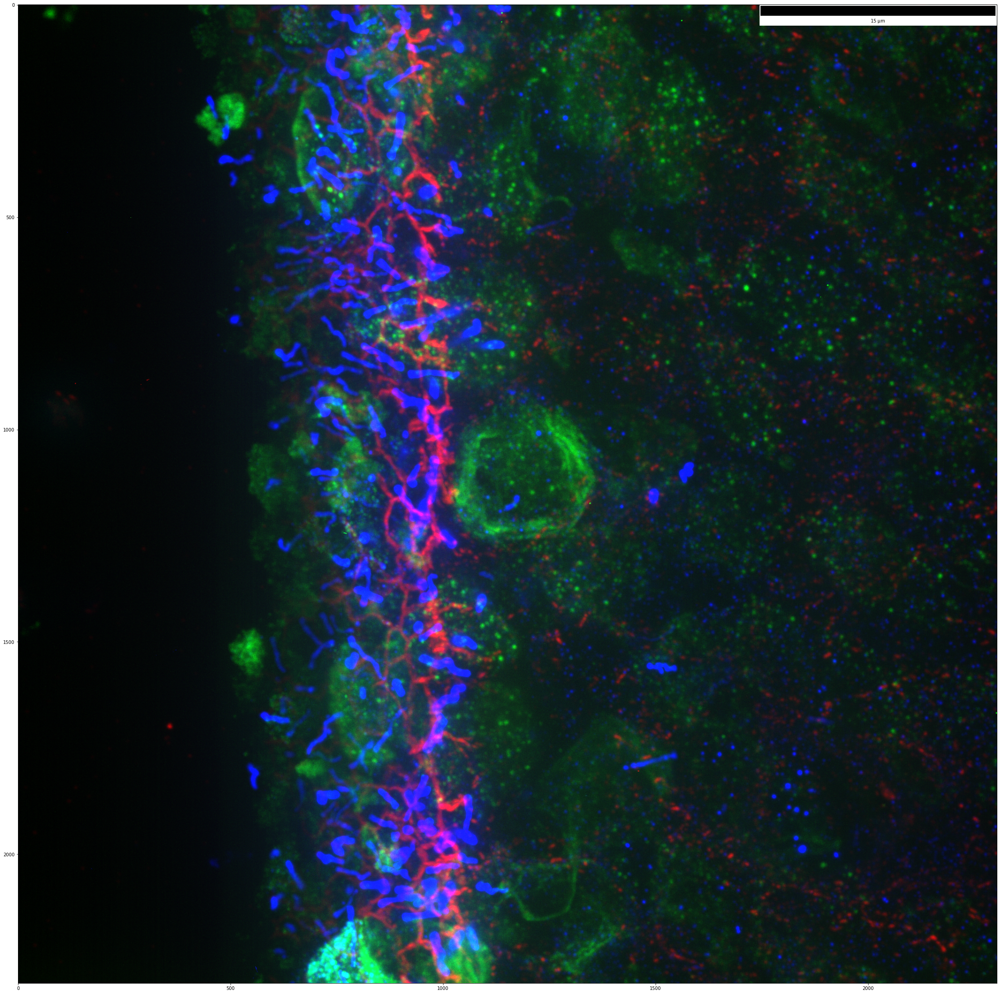

In [11]:
well = 1
scalebar = ScaleBar(0.0271, "um", length_fraction=0.25)
filename1 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 1)]['file'].values[0]
filename2 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 2)]['file'].values[0]
filename3 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 3)]['file'].values[0]
filename4 = metadf[(metadf['well_id'] == well)& (metadf['channel'] == 4)]['file'].values[0]

img1 = io.imread(rawpath + filename1)
img2 = io.imread(rawpath + filename2)
img3 = io.imread(rawpath + filename3)
img4 = io.imread(rawpath + filename4)

r = modules.scale_image(img1,0.1)
g = modules.scale_image(img2,0.1)
b = modules.scale_image(img3,0.1)
stack = np.dstack([r/65535,g/65535,b/65535])

plt.figure(figsize = (40,40))
plt.imshow(stack)
plt.gca().add_artist(scalebar)
#plt.axis('off')
#plt.savefig(data_path + 'exp1_SoRa/plots/' + str(well) + '_zoom.pdf')
plt.show()

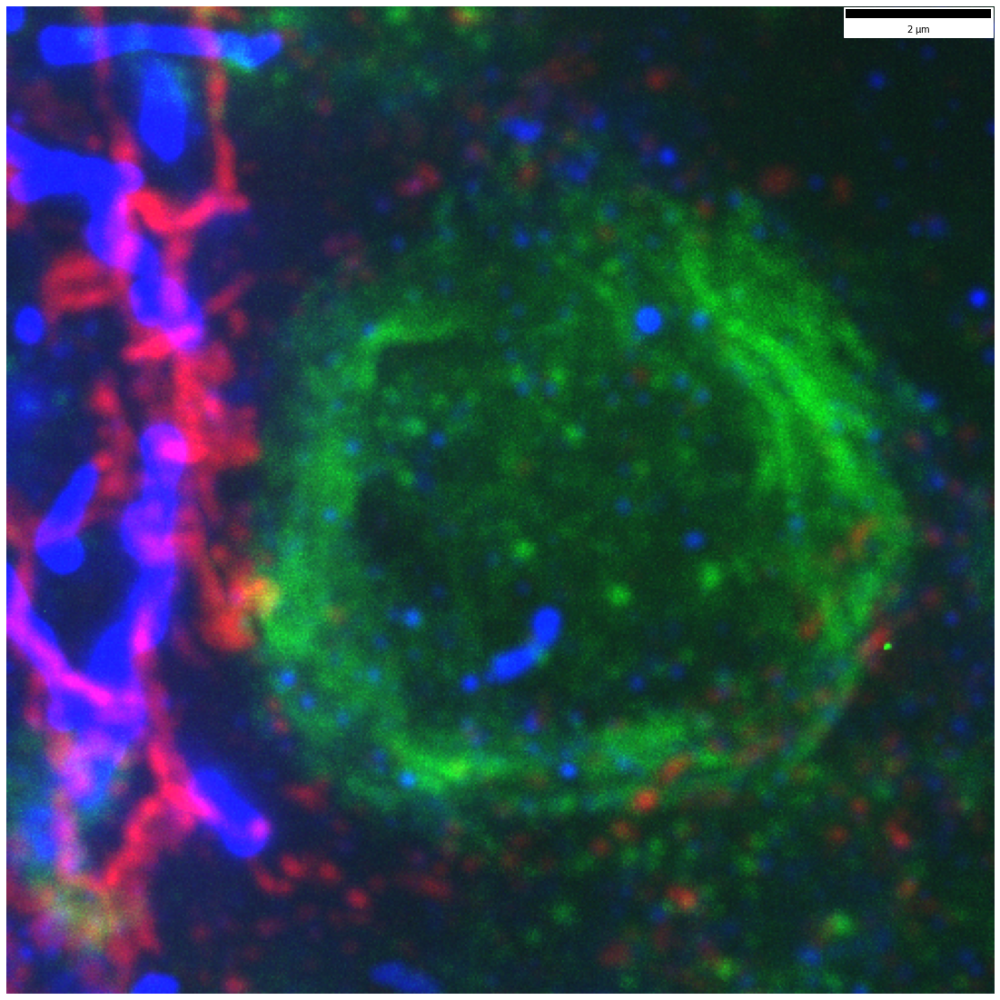

In [15]:
scalebar = ScaleBar(0.0271, "um", length_fraction=0.25)
plt.figure(figsize = (20,20))
plt.imshow(stack[850:1350,900:1400,:])
plt.gca().add_artist(scalebar)
plt.axis('off')
#plt.savefig(data_path + 'exp1_SoRa/plots/' + str(well) + '_zoom2.pdf')
plt.show()

In [59]:
rawpath = '/links/groups/treutlein/DATA/imaging/PW/proliferating_RGC/megastack/002/'
metadf = modules.get_metadata(rawpath)

In [60]:
import skimage

for well in np.unique(metadf['well_id']):
    for channel in np.unique(metadf['channel']):
        imgs = []
        for plane in np.unique(metadf['plane']):
            filename = metadf[(metadf['well_id'] == well) & (metadf['channel'] == channel) & (metadf['plane'] == plane)]['file'].values[0]
            imgs.append(io.imread(rawpath + filename))
        stack = np.dstack(imgs)
        stack = stack.swapaxes(0,2)
        stack = stack.swapaxes(1,2)
        #io.imsave('/links/groups/treutlein/DATA/imaging/PW/proliferating_RGC/exp1_SoRa/stacks/' + filename, stack)
        skimage.io.imsave('/links/groups/treutlein/DATA/imaging/PW/proliferating_RGC/exp4/stacks/' + filename, stack,photometric='minisblack')

/home/pwahle/anaconda3/envs/retina/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: /links/groups/treutlein/DATA/imaging/PW/proliferating_RGC/exp4/stacks/xy1z89c1.tif is a low contrast image
  del sys.path[0]
/home/pwahle/anaconda3/envs/retina/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: /links/groups/treutlein/DATA/imaging/PW/proliferating_RGC/exp4/stacks/xy1z89c2.tif is a low contrast image
  del sys.path[0]
/home/pwahle/anaconda3/envs/retina/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: /links/groups/treutlein/DATA/imaging/PW/proliferating_RGC/exp4/stacks/xy1z89c3.tif is a low contrast image
  del sys.path[0]
/home/pwahle/anaconda3/envs/retina/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: /links/groups/treutlein/DATA/imaging/PW/proliferating_RGC/exp4/stacks/xy1z89c4.tif is a low contrast image
  del sys.path[0]
